In [59]:
# Start writing code here...

from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.dummy import DummyClassifier
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.model_selection import (
    GridSearchCV,
    RandomizedSearchCV,
    cross_val_score,
    cross_validate,
    train_test_split,
)
from sklearn.impute import SimpleImputer
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import altair as alt
import nltk
from collections import Counter
import numpy as np
from sklearn.feature_extraction import DictVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LogisticRegression
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt

nltk.download('stopwords')

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/jeremy.zhang/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [60]:
from feature_extractions_helper import *

In [61]:
df = pd.read_csv("data/processed/processed_data_7760.csv")

In [62]:
df.head()

,Unnamed: 0,created_at,id,full_text,entities,is_quote_status,retweet_count,favorite_count,possibly_sensitive,keyword,...,tags_count,cap_words_count,slang_acronym_count,sentence_count,avg_pos_words,avg_neg_words,avg_slang_sent,avg_len_sent,avg_len_tokens,processed_text
0,0,Mon Dec 21 17:31:03 +0000 2020,1.341074e+18,Today we add an important chapter to a Europea...,"['COVID19', 'EUvaccinationdays']",False,1557.0,5840.0,False,Covid19 vaccine,...,"(9, 3, 0, 0)",2,0,2,0.086957,0.0,-0.025641,20.000000,4.850000,today we add an important chapter to a europea...
1,1,Tue Dec 22 20:20:16 +0000 2020,1.341479e+18,Sedgwick County has received its first allocat...,['COVID19'],False,9.0,50.0,False,Covid19 vaccine,...,"(8, 6, 0, 1)",2,0,2,0.000000,0.0,0.000000,19.000000,5.421053,sedgwick county ha receive it first allocation...
2,2,Wed Dec 23 00:32:16 +0000 2020,1.341542e+18,Now is not the time to let up. Vaccines are he...,['COVID19'],False,0.0,0.0,False,Covid19 vaccine,...,"(13, 2, 4, 0)",1,0,2,0.020000,0.0,0.023256,21.500000,4.720930,now be not the time to let up vaccine be here ...
3,3,Tue Dec 22 16:34:35 +0000 2020,1.341422e+18,I received my #COVID19 vaccination today. It w...,['COVID19'],False,139.0,1008.0,False,Covid19 vaccine,...,"(10, 1, 2, 0)",3,0,3,0.083333,0.0,0.000000,14.333333,4.627907,i receive my covid vaccination today it wa gre...
4,4,Sat Dec 19 18:58:07 +0000 2020,1.340371e+18,. Gen. Gus Perna on the distribution of the Mo...,['COVID19'],False,325.0,1784.0,False,Covid19 vaccine,...,"(2, 5, 0, 0)",1,0,4,0.000000,0.0,0.000000,3.750000,4.642857,gen gu perna on the distribution of the modern...


## Data Splitting

In [63]:
train_df, test_df = train_test_split(df, test_size = 0.2, random_state=123)

In [64]:
print(train_df.shape)
print(test_df.shape)

(6208, 34)
(1552, 34)


## EDA

In [65]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6208 entries, 7461 to 3582
Data columns (total 34 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Unnamed: 0                6208 non-null   int64  
 1   created_at                6208 non-null   object 
 2   id                        6208 non-null   float64
 3   full_text                 6208 non-null   object 
 4   entities                  6208 non-null   object 
 5   is_quote_status           6208 non-null   bool   
 6   retweet_count             6208 non-null   float64
 7   favorite_count            6208 non-null   float64
 8   possibly_sensitive        3835 non-null   object 
 9   keyword                   6208 non-null   object 
 10  location                  4686 non-null   object 
 11  hashtags_count            6208 non-null   float64
 12  city                      2733 non-null   object 
 13  province                  2292 non-null   object 
 14  count

<AxesSubplot:>

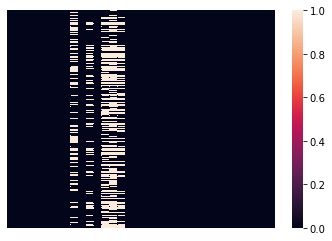

In [66]:
sns.heatmap(train_df.isna(), xticklabels=False, yticklabels=False)

In [67]:
alt.data_transformers.disable_max_rows()
alt.Chart(train_df).mark_bar().encode(
    alt.X("sentiment", title="Tweet sentiment"),
    alt.Y("count()", title="Number of tweets")
).properties(title="Number of tweets across all sentiments", width=200)

alt.Chart(...)

In [68]:
alt.Chart(train_df).mark_bar().encode(
    alt.X("country", title="Counrty", sort='-y'),
    alt.Y("count(sentiment)", title="Number of tweets"),
).properties(title="Number of tweets across all countries")

alt.Chart(...)

In [86]:
counrty_majority = train_df.query("country in ['United States', 'United Kingdom', 'Canada', 'India']")
alt.Chart(country_majority).mark_bar().encode(
    alt.X("count()", title="Number of tweets"),
    alt.Y("sentiment", title="Tweet sentiment"),
    alt.Color("sentiment", title="Tweet sentiment"),
).properties(height=80).facet(row="country")

alt.FacetChart(...)

In [70]:
subset_usa = train_df[train_df["country"] == "United States"]
alt.Chart(subset_usa).mark_bar().encode(
    alt.X("province", title="USA Province code", sort="-y"),
    alt.Y("count(sentiment)", title="Number of tweets")
).properties(title="Number of tweets across all provinces in USA")

alt.Chart(...)

In [71]:
alt.Chart(subset_usa.query("province in ['NY', 'CA', 'DC']")).mark_bar().encode(
    alt.X("count()", title="Number of tweets"),
    alt.Y("sentiment", title="Tweet sentiment"),
    alt.Color("sentiment", title="Tweet sentiment"),
).properties(height=80).facet(row="province")

alt.FacetChart(...)

<AxesSubplot:>

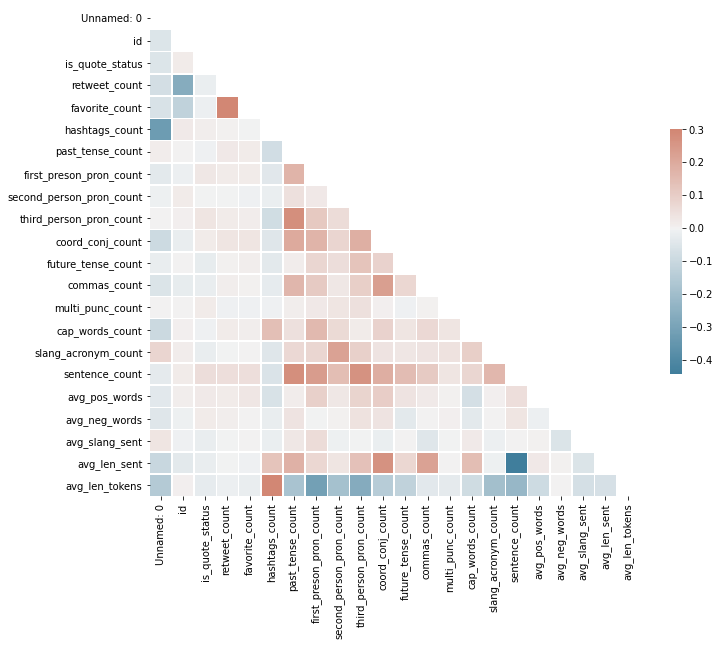

In [72]:
# Compute the correlation matrix
corr = train_df.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [73]:
numeric_cols = train_df.select_dtypes('number').drop(columns=[
    'id','retweet_count', 'favorite_count', 'Unnamed: 0']).columns.tolist()

(alt.Chart(train_df).mark_bar().encode(
    alt.X(alt.repeat(), type='quantitative', bin=alt.Bin(maxbins=40)),
    y='count()',
    color="sentiment")
 .properties(height=80, width=200)
 .repeat(repeat=numeric_cols, columns=2))

alt.RepeatChart(...)

In [84]:
alt.Chart(train_df).mark_bar().encode(
    alt.X("count()", title="Number of tweets"),
    alt.Y("sentiment", title="Tweet sentiment"),
    alt.Color("keyword")
).properties(height=80).facet(row="keyword")

alt.FacetChart(...)

In [74]:
stopwords = STOPWORDS | {"amp", "vaccine","vaccines", "covid 19", "covid", "covid19", "will", 'covid19 vaccine', 'pfizer', 'astrazeneca', 'moderna'}
wordcloud = WordCloud(background_color="white", max_words=2000, stopwords=stopwords)

def generate_wordcloud(wordCloud, subset):
    sub_df = train_df[train_df["sentiment"] == subset]
    text = " ".join(sub_df.full_text).lower()
    wordcloud.generate(text)
    fig = plt.figure()
    fig.set_figwidth(14) # set width
    fig.set_figheight(18) # set height
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()

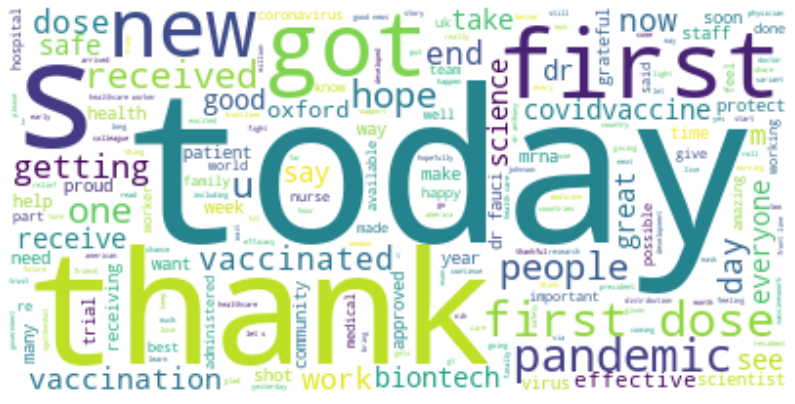

In [79]:
generate_wordcloud(wordcloud, "pos")

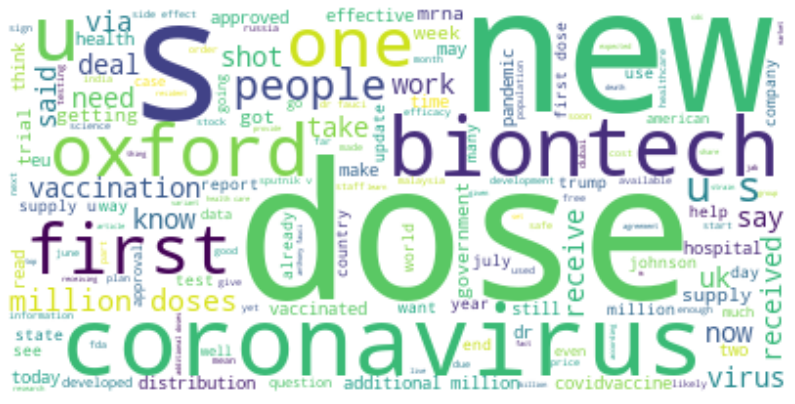

In [80]:
generate_wordcloud(wordcloud, "neu")

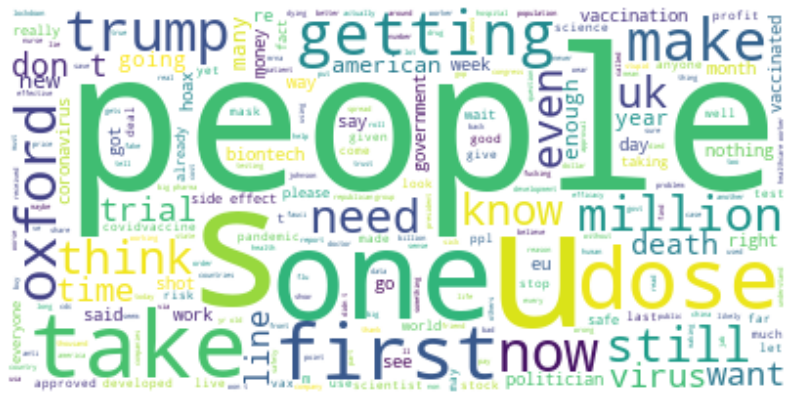

In [81]:
generate_wordcloud(wordcloud, "neg")

## Feature Categories

In [75]:
drop_features = ["created_at", "id", "entities", "is_quote_status", "location", "tags_count"] # I'll add tags_counts later
target = "sentiment"
categorical_features = ["keyword", "city", "province", "country"]
text_feature = "full_text"

In [76]:
numeric_list = train_df.select_dtypes(include=np.number).columns.tolist()
numeric_set = set(numeric_list) - {"Unnamed: 0", "id"}
numeric_set.add("possibly_sensitive") # numeric feature
numeric_features = list(numeric_set)

In [77]:
# spliting X_train and y_train

X_train, y_train = train_df.drop(columns=drop_features).drop(columns=[target]), train_df[target]
X_test, y_test = test_df.drop(columns=drop_features).drop(columns=[target]), test_df[target]

## Preprocessing

In [78]:
numeric_transformer = make_pipeline(SimpleImputer(strategy="median"),
                                    StandardScaler())
categorical_transformer = make_pipeline(SimpleImputer(strategy="constant", fill_value="missing"),
                                        OneHotEncoder(handle_unknown="ignore"))


preprocessor = make_column_transformer(
    (numeric_transformer, numeric_features),
    (categorical_transformer, categorical_features),
    (CountVectorizer(ngram_range=(1, 2), stop_words=stopwords.words("english")), text_feature) # unigram and bigram
);

AttributeError: 'set' object has no attribute 'words'

In [ ]:
X_train_enc = preprocessor.fit_transform(X_train, y_train)

In [ ]:
# vocabulary list 
vocab = preprocessor.named_transformers_['countvectorizer'].vocabulary_

In [ ]:
# getting feature names
num_features = numeric_features
ohe_features = preprocessor.named_transformers_['pipeline-2']['onehotencoder'].get_feature_names().tolist()
vocab = preprocessor.named_transformers_['countvectorizer'].get_feature_names()

enc_columns = num_features + ohe_features + vocab

In [ ]:
# the number of features we have
len(enc_columns)

## Baseline Model

In [ ]:
# The scoring function is adapted from the lecture note of DSCI-573.


results = {}

def mean_std_cross_val_scores(model, X_train, y_train, **kwargs):
    """
    Returns mean and std of cross validation.
    """
    scores = cross_validate(model, X_train, y_train, **kwargs)

    mean_scores = pd.DataFrame(scores).mean()
    std_scores = pd.DataFrame(scores).std()
    out_col = []

    for i in range(len(mean_scores)):
        out_col.append((f"%0.3f (+/- %0.3f)" % (mean_scores[i], std_scores[i])))

    return pd.Series(data=out_col, index=mean_scores.index)

In [ ]:
dummy = make_pipeline(preprocessor, DummyClassifier(strategy="most_frequent"))

In [ ]:
results["dummy"] = mean_std_cross_val_scores(dummy, X_train, y_train, return_train_score=True)

In [ ]:
pd.DataFrame(results).T

## Models

### Logistic Regression

In [ ]:
pipe_lr = make_pipeline(preprocessor, LogisticRegression(random_state=123, max_iter=2000, class_weight="balanced"))

In [ ]:
results["Logistic Regression"] = mean_std_cross_val_scores(pipe_lr, X_train, y_train, return_train_score=True)

In [ ]:
pd.DataFrame(results)

## Feature Selection

## Hyperparameter Optimization

## Interpretation